## Resultados correspondientes a entrenamiento de un pulso triangular como condición inicial

In [1]:

import numpy as np
import jax
import matplotlib.pyplot as plt
import jax.numpy as jnp

from fbpinns.analysis import load_model, FBPINN_solution

import fbpinn_wave as fw
from fbpinn_wave import ExactAny, Wave1DTriang

jax.devices()

[CpuDevice(id=0)]

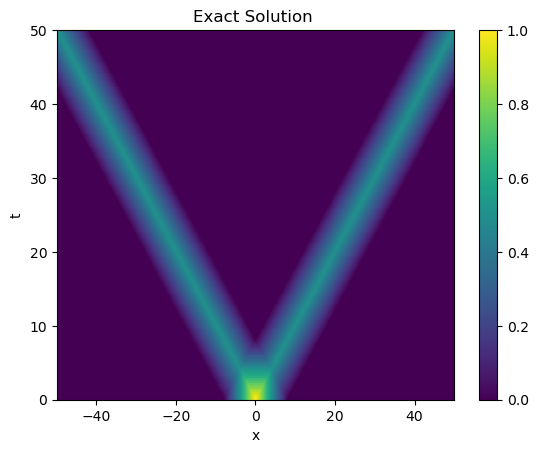

In [3]:
Wave1DTriang()
sol = ExactAny("exact_triang.mat")
sol.plot_colormap()
#sol.animation()

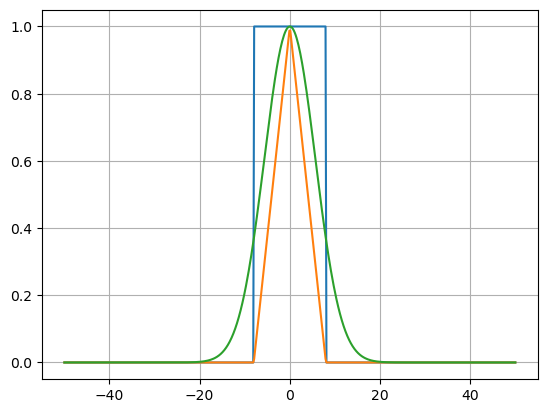

In [7]:
def rect(mu, w, x):
  r = np.ones_like(x)
  r[x < mu - w/2] = 0
  r[x > mu + w/2] = 0
  return r

mu = 0
w = 16
sigma = w/4
x = jnp.linspace(-50, 50, 500)
t = fw.triang(-0, w, x)

r = rect(mu, w, x)

plt.plot(x, r)
plt.plot(x, t)
plt.plot(x, np.exp(-0.5*(x-mu)**2/2/sigma**2))
plt.grid()

`results_s_t0`: 20x20 dominios 5 de superposición y condiciones soft. Redes de (2, 16, 16, 16, 16, 16, 16, 16, 1) y sin suavizar. Con planificador. 120x120 puntos

[INFO] 2025-07-18 15:54:19 - Loading model from:
results_s_t0/models/test/model_00100000.jax


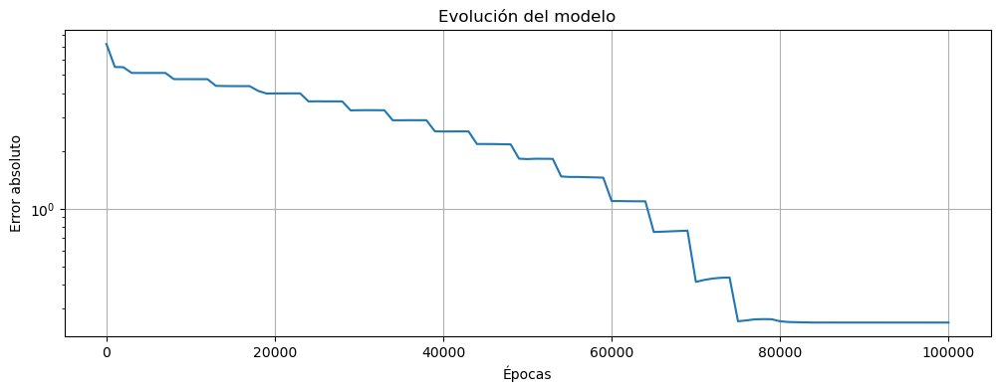

In [8]:
const, model = load_model(run="test", i=100000, rootdir="results_s_t0/")
fw.plot_model_loss(model, const, axis='Epochs')

In [9]:
i, all_params, _, active, _ = model
#x, t , c_axis = np.meshgrid(sol.x, sol.t, c, indexing='xy')
x, t = np.meshgrid(sol.x, sol.t, indexing='xy')
u = FBPINN_solution(const, all_params, active, np.c_[x.flatten(), t.flatten()])

[INFO] 2025-07-18 15:54:24 - x_batch
[INFO] 2025-07-18 15:54:24 - (160599, 2), float64, ndarray
[INFO] 2025-07-18 15:54:24 - x_take
[INFO] 2025-07-18 15:54:24 - (3669068, 2), float64, ndarray


In [10]:
ecm = np.mean((sol.u - u.reshape((sol.Nt, sol.Nx)).T[:,:-1])**2)

print('ECM = ' + str(ecm))

#sol = ExactMulti('exact_extended.mat')
#sol.plot_colormap(cmap='jet')
sol.animation(compare=True, u_compare=u.reshape((sol.Nt, sol.Nx)).T)

ECM = 0.0058609126


`results_s_t1`: 4x4 dominios 5 de superposición y condiciones soft. Redes de (2, 16, 16, 16, 16, 1) y sin suavizar. Sin planificador. 75x75 puntos

[INFO] 2025-07-18 15:56:28 - Loading model from:
results_s_t1/models/test/model_00100000.jax


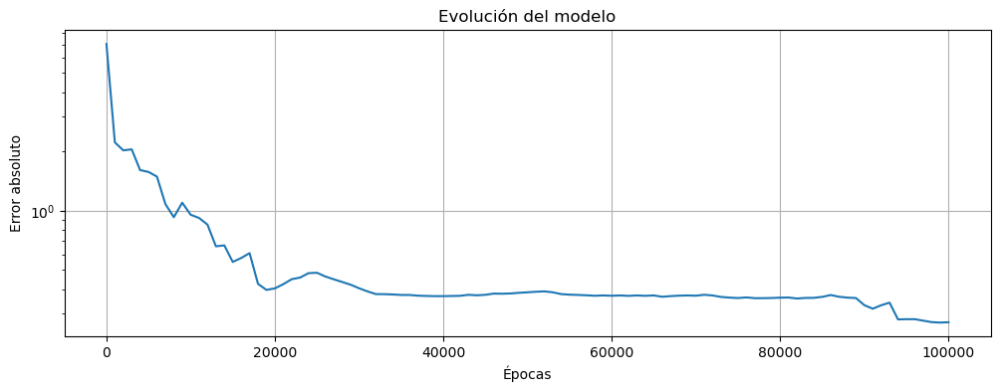

In [11]:
const, model = load_model(run="test", i=100000, rootdir="results_s_t1/")
fw.plot_model_loss(model, const, axis='Epochs')

In [12]:
i, all_params, _, active, _ = model
#x, t , c_axis = np.meshgrid(sol.x, sol.t, c, indexing='xy')
x, t = np.meshgrid(sol.x, sol.t, indexing='xy')
u = FBPINN_solution(const, all_params, active, np.c_[x.flatten(), t.flatten()])

ecm = np.mean((sol.u - u.reshape((sol.Nt, sol.Nx)).T[:,:-1])**2)

print('ECM = ' + str(ecm))

#sol = ExactMulti('exact_extended.mat')
#sol.plot_colormap(cmap='jet')
sol.animation(compare=True, u_compare=u.reshape((sol.Nt, sol.Nx)).T)

[INFO] 2025-07-18 15:56:31 - x_batch
[INFO] 2025-07-18 15:56:31 - (160599, 2), float64, ndarray
[INFO] 2025-07-18 15:56:31 - x_take
[INFO] 2025-07-18 15:56:31 - (2153536, 2), float64, ndarray
ECM = 0.0051441127


`results_s_t2`: 4x4 dominios 3 de superposición y condiciones soft. Redes de (2, 16, 16, 16, 16, 16, 16, 1) y sin suavizar. Sin planificador. 100x100 puntos

[INFO] 2025-07-18 15:56:56 - Loading model from:
results_s_t2/models/test/model_00030000.jax


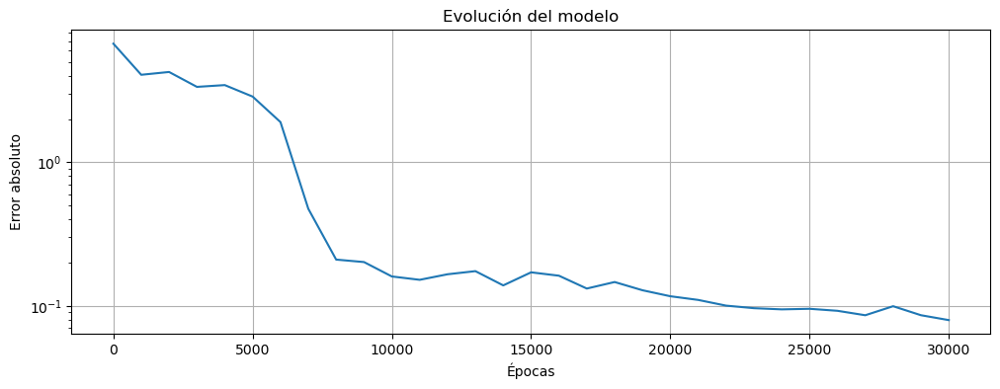

In [13]:
const, model = load_model(run="test", i=30000, rootdir="results_s_t2/")
fw.plot_model_loss(model, const, axis='Epochs')

In [14]:
i, all_params, _, active, _ = model
#x, t , c_axis = np.meshgrid(sol.x, sol.t, c, indexing='xy')
x, t = np.meshgrid(sol.x, sol.t, indexing='xy')
u = FBPINN_solution(const, all_params, active, np.c_[x.flatten(), t.flatten()])

ecm = np.mean((sol.u - u.reshape((sol.Nt, sol.Nx)).T[:,:-1])**2)

print('ECM = ' + str(ecm))

#sol = ExactMulti('exact_extended.mat')
#sol.plot_colormap(cmap='jet')
sol.animation(compare=True, u_compare=u.reshape((sol.Nt, sol.Nx)).T)

[INFO] 2025-07-18 15:56:57 - x_batch
[INFO] 2025-07-18 15:56:57 - (160599, 2), float64, ndarray
[INFO] 2025-07-18 15:56:57 - x_take
[INFO] 2025-07-18 15:56:57 - (1140608, 2), float64, ndarray
ECM = 0.0001783344


`results_s_t_extra2`: 4x10 dominios 3 de superposición y condiciones soft. Redes de (2, 32, 16, 16, 16, 16, 16, 1) y sin suavizar. Con planificador. 100x100 puntos. Se va a usar luego para desplazar y obtener para distintos $\mu$.

`results_s_t_extra1`: 4x4 dominios 3 de superposición y condiciones soft. Redes de (2, 32, 16, 16, 16, 16, 16, 1) y sin suavizar. Con planificador. 120x120 puntos. Se va a usar luego para desplazar y obtener para distintos $\mu$.

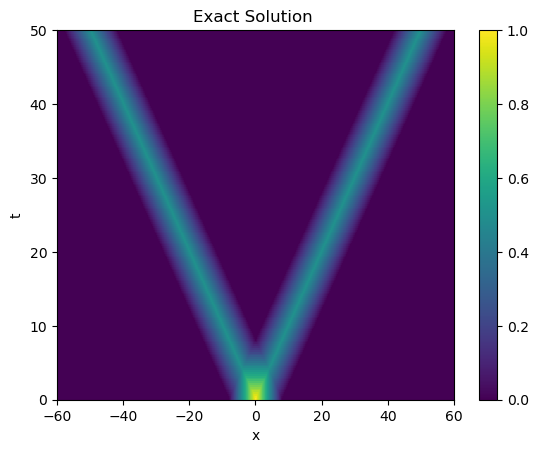

In [15]:
sol = ExactAny("exact_triang_extra.mat")
sol.plot_colormap()
#sol.animation()

[INFO] 2025-07-18 15:57:20 - Loading model from:
results_s_t_extra1/models/test/model_00030000.jax


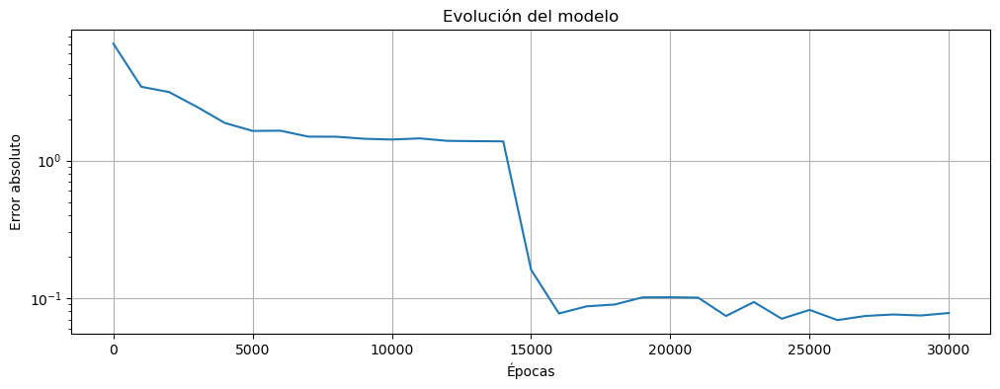

In [16]:
const, model = load_model(run="test", i=30000, rootdir="results_s_t_extra1/")
fw.plot_model_loss(model, const, axis='Epochs')

In [17]:
i, all_params, _, active, _ = model
#x, t , c_axis = np.meshgrid(sol.x, sol.t, c, indexing='xy')
x, t = np.meshgrid(sol.x, sol.t, indexing='xy')
u = FBPINN_solution(const, all_params, active, np.c_[x.flatten(), t.flatten()])

ecm = np.mean((sol.u - u.reshape((sol.Nt, sol.Nx)).T[:,:-1])**2)
ecm = np.format_float_scientific(ecm, precision=3)

print('ECM = ' + str(ecm))

sol.animation(compare=True, u_compare=u.reshape((sol.Nt, sol.Nx)).T)

[INFO] 2025-07-18 15:57:22 - x_batch
[INFO] 2025-07-18 15:57:22 - (193161, 2), float64, ndarray
[INFO] 2025-07-18 15:57:22 - x_take
[INFO] 2025-07-18 15:57:22 - (1374304, 2), float64, ndarray
ECM = 2.421e-04


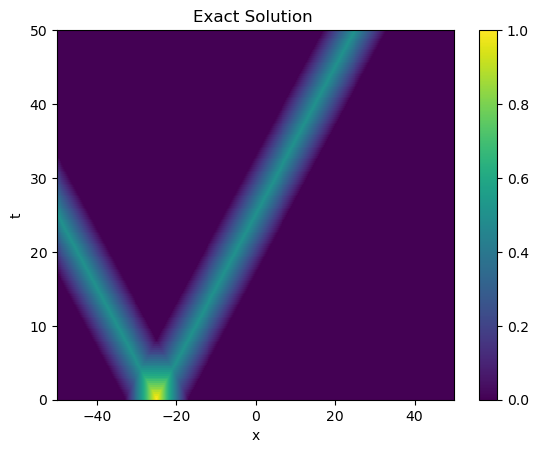

In [6]:
#Prueba desplazar
sol2 = ExactAny("exact_triang_extra.mat")
sol2.u, sol2.x = fw.shift_solution_1d(sol2.u, -25, sol2.x, [-50, 50])
sol2.plot_colormap()